**Reference:**  
[PyTorch tutorial](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html)


In [0]:
import torch
import torchvision
import random

manualSeed = 999
random.seed(manualSeed)
torch.manual_seed(manualSeed)

In [0]:
num_workers = 4
batch_size = 256
image_size = 32
nc = 3 # channels
nz = 100 # latent vec
ngf = 64 # size of feature maps in generator
ndf = 64 # size of feature maps in discrimnator
num_epochs = 150
lr = 2e-4
beta1 = 0.5 # For Adam
ngpu = 1

device = 'cuda:0' if torch.cuda.is_available() else 'gpu'
torch.backends.cudnn.benchmark = True

In [0]:
dataset = torchvision.datasets.CIFAR10('./',train=True, transform=torchvision.transforms.Compose([torchvision.transforms.ToTensor(),torchvision.transforms.Normalize([0.5,0.5,0.5], [0.5,0.5,0.5])]),download=True)

Files already downloaded and verified


In [0]:
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=num_workers)

In [0]:
def weights_init(m):
  classname = m.__class__.__name__
  if classname.find('Conv') != -1:
    torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
  elif classname.find('BatchNorm') != -1:
    torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
    torch.nn.init.constant_(m.bias.data, 0)

## Generator

In [0]:
class Generator(torch.nn.Module):
  def __init__(self, ngpu):
    super(Generator, self).__init__()
    self.ngpu=ngpu
    self.block1 = torch.nn.Sequential(
        torch.nn.ConvTranspose2d(nz, ngf*4, 4, 1, 0, bias=False),
        torch.nn.BatchNorm2d(ngf*4),
        torch.nn.ReLU(inplace=True)
    )
    # (ngf*8) x 4 x 4
    self.block2 = torch.nn.Sequential(
        torch.nn.ConvTranspose2d(ngf*4, ngf*2, 4, 2, 1, bias=False),
        torch.nn.BatchNorm2d(ngf*2),
        torch.nn.ReLU(True)
    )
    # (ngf*4) x 8 x 8
    self.block3 = torch.nn.Sequential(
        torch.nn.ConvTranspose2d(ngf*2, ngf, 4, 2, 1, bias=False),
        torch.nn.BatchNorm2d(ngf),
        torch.nn.ReLU(True)
    )
    # (ngf*2) x 16 x 16
    self.block4 = torch.nn.Sequential(
        torch.nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
        torch.nn.Tanh()
        # torch.nn.BatchNorm2d(ngf),
        # torch.nn.ReLU(True)
    )
    # (ngf) x 32 x 32
    # self.block5 = torch.nn.Sequential(
    #     torch.nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
    #     torch.nn.Tanh()
    # )

  def forward(self, x):
    x = self.block1(x)
    x = self.block2(x)
    x = self.block3(x)
    x = self.block4(x)
    # x = self.block5(x)
    return x

netG = Generator(ngpu).to(device)
netG.apply(weights_init)
netG

Generator(
  (block1): Sequential(
    (0): ConvTranspose2d(100, 256, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
  )
  (block2): Sequential(
    (0): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
  )
  (block3): Sequential(
    (0): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
  )
  (block4): Sequential(
    (0): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): Tanh()
  )
)

## Discriminator

In [0]:
class Discriminator(torch.nn.Module):
  def __init__(self, ngpu):
    super(Discriminator, self).__init__()
    self.ngpu = ngpu
    self.block1 = torch.nn.Sequential(
        torch.nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
        torch.nn.LeakyReLU(0.2, inplace=True)
    )
    self.block2 = torch.nn.Sequential(
        torch.nn.Conv2d(ndf, ndf*2, 4, 2, 1, bias=False),
        torch.nn.BatchNorm2d(ndf*2),
        torch.nn.LeakyReLU(0.2, inplace=True)
    )
    self.block3 = torch.nn.Sequential(
        torch.nn.Conv2d(ndf*2, ndf*4, 4, 2, 1, bias=False),
        torch.nn.BatchNorm2d(ndf*4),
        torch.nn.LeakyReLU(0.2, inplace=True)
    )
    self.block4 = torch.nn.Sequential(
        torch.nn.Conv2d(ndf*4, 1, 4, 2, 0, bias=False),
        torch.nn.Sigmoid()
        # torch.nn.BatchNorm2d(ndf*8),
        # torch.nn.LeakyReLU(0.2, inplace=True)
    )
    # self.block5 = torch.nn.Sequential(
    #     torch.nn.Conv2d(ndf*8, 1, 4, 1, 0, bias=False),
    #     torch.nn.Sigmoid()
    # )

  def forward(self, x):
    x = self.block1(x)
    x = self.block2(x)
    x = self.block3(x)
    x = self.block4(x)
    # x = self.block5(x)
    return x

netD = Discriminator(ngpu).to(device)
netD.apply(weights_init)
netD

Discriminator(
  (block1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (block2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (block3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.2, inplace=True)
  )
  (block4): Sequential(
    (0): Conv2d(256, 1, kernel_size=(4, 4), stride=(2, 2), bias=False)
    (1): Sigmoid()
  )
)

## Loss and Optimizer

In [0]:
criterion = torch.nn.BCELoss()
fixed_noise = torch.randn(64, nz, 1, 1, device=device)
real_label = 1
fake_label = 0

optimizerD = torch.optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = torch.optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

## Train

In [0]:
img_list = []
G_losses = []
D_losses = []
iters = 0

print('Starting Training Loop...')

for epoch in range(1, num_epochs+1):
  for i, data in enumerate(dataloader, 0):
    ### Update D network: maximize log(D(x)) + log(1-D(G(z)))

    # Train with all-REAL batch
    netD.zero_grad()
    real_cpu = data[0].to(device)
    b_size = real_cpu.size(0)
    label = torch.full((b_size,), real_label, device=device)
    output=netD(real_cpu).view(-1)
    errD_real = criterion(output, label)
    errD_real.backward()
    D_x = output.mean().item()

    # Train with all-FAKE batch
    noise = torch.randn(b_size, nz, 1, 1, device=device)
    fake = netG(noise)
    label.fill_(fake_label)
    output=netD(fake.detach()).view(-1)
    errD_fake = criterion(output, label)
    errD_fake.backward()
    D_G_z1 = output.mean().item()
    errD = errD_real + errD_fake

    # Update D
    optimizerD.step()

    ### Update G network: maximize log(D(G(z)))
    netG.zero_grad()
    label.fill_(real_label)
    output = netD(fake).view(-1)
    # Want netD to seem fake images as REAL by training netG
    errG = criterion(output, label)
    errG.backward()
    D_G_z2 = output.mean().item()

    optimizerG.step()

    # Output training stats
    if i+1  == len(dataloader):
        print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
              % (epoch, num_epochs, i+1, len(dataloader),
                  errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

    # Save Losses for plotting later
    G_losses.append(errG.item())
    D_losses.append(errD.item())

    # Check how the generator is doing by saving G's output on fixed_noise
    if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
        with torch.no_grad():
            fake = netG(fixed_noise).detach().cpu()
        img_list.append(torchvision.utils.make_grid(fake, padding=2, normalize=True))

    iters += 1



Starting Training Loop...
[1/150][196/196]	Loss_D: 0.1802	Loss_G: 3.9356	D(x): 0.8657	D(G(z)): 0.0221 / 0.0239
[2/150][196/196]	Loss_D: 0.4300	Loss_G: 4.8743	D(x): 0.8974	D(G(z)): 0.2436 / 0.0114
[3/150][196/196]	Loss_D: 0.3728	Loss_G: 3.5076	D(x): 0.7690	D(G(z)): 0.0657 / 0.0569
[4/150][196/196]	Loss_D: 0.4539	Loss_G: 2.3826	D(x): 0.7446	D(G(z)): 0.0988 / 0.1267
[5/150][196/196]	Loss_D: 0.6010	Loss_G: 3.1131	D(x): 0.7586	D(G(z)): 0.1918 / 0.0723
[6/150][196/196]	Loss_D: 0.3163	Loss_G: 3.0031	D(x): 0.8679	D(G(z)): 0.1414 / 0.0688
[7/150][196/196]	Loss_D: 0.2895	Loss_G: 2.8153	D(x): 0.8939	D(G(z)): 0.1477 / 0.0814
[8/150][196/196]	Loss_D: 0.3963	Loss_G: 2.7077	D(x): 0.8193	D(G(z)): 0.1432 / 0.1005
[9/150][196/196]	Loss_D: 0.5506	Loss_G: 3.0557	D(x): 0.8662	D(G(z)): 0.2904 / 0.0673
[10/150][196/196]	Loss_D: 0.4213	Loss_G: 2.8443	D(x): 0.8507	D(G(z)): 0.2060 / 0.0714
[11/150][196/196]	Loss_D: 0.6492	Loss_G: 1.8717	D(x): 0.6365	D(G(z)): 0.1097 / 0.1940
[12/150][196/196]	Loss_D: 0.4185	Loss

## Visualization

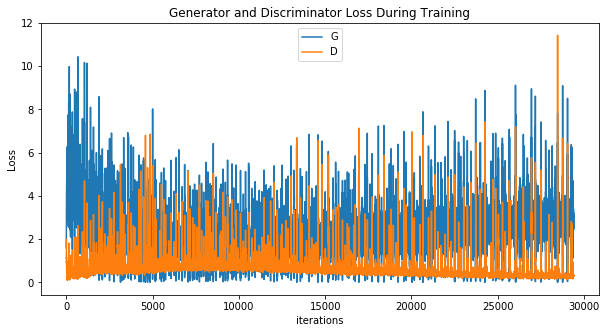

In [0]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

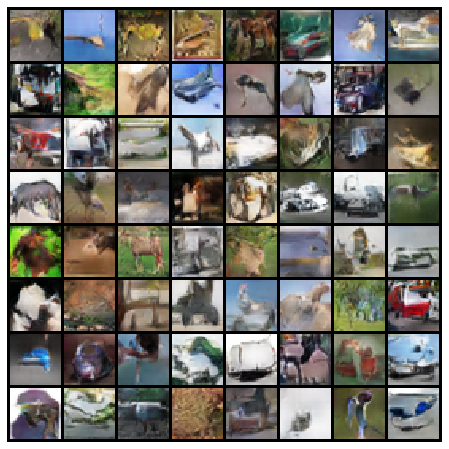

In [0]:
import matplotlib.animation as animation
from IPython.display import HTML
import numpy as np

#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

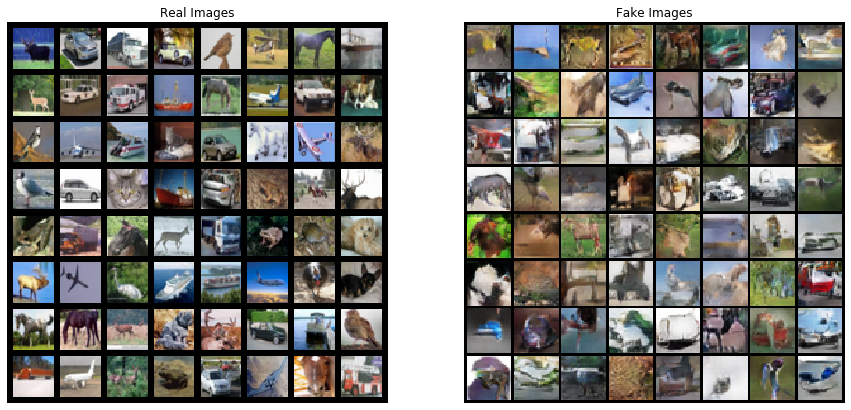

In [0]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(torchvision.utils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()